In [1]:
from utils import *

# display(HTML('''<script>
# console.log('Hidding code input')
# $('div.code_cell > div.input > div.inner_cell').hide();
# $('div.prompt_container').click(
# function(){
# $(this).siblings().toggle("slow" );
# })
# </script>'''))

display(HTML("""
<style>
.output_png, div.output_text, div.output_html {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
"""))

In [2]:
mpl.rcParams['figure.figsize'] = (12, 4)
mpl.rcParams['font.size'] = 22
temp_dir = './temp'

<center>

<h1>Teaching Math Through Music</h1>


<h3>Pablo E. Riera</h3>
<h3>Laboratorio de Inteligencia Artificial Aplicada</h3>
<h3>Universidad de Buenos Aires</h3>

<h4>
Musica 2020<br />
Rio de Janeiro - 5 do fevereiro 2020<br />
Instituto de Matemática Pura e Aplicada<br />
</h4>
</center>

# Teaching Math Through Music

## Context

- Math applied to music course at National University of Quilmes
- Last year students of music technology degree 
- Minor experience in math and programming

## Course topics

- Number systems
- Sequences
- Functions 
- Basic calculus
- Fourier Analysis
- Digital Filters
- Physical modelling
- Random numbers and probability

## Programming

* Python
* Pure Data (real time modular sound system)
* Live coding music tools

## Sonification

Display data, functions, patterns and concepts with audio


* Kramer, G. (2000). Auditory display: sonification, audification and auditory interfaces. Addison-Wesley Longman Publishing Co., Inc..

## Sonification example: number sequences as melodies

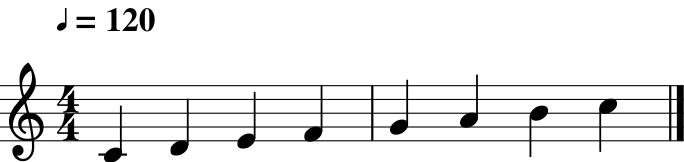

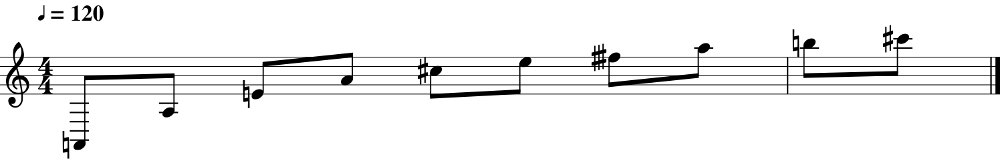

In [3]:
seq = [0, 1, 2, 3, 4, 5, 6, 7]                               # notes sequence
score = secuencia(seq,bpm=120, 
                  scale=m21.scale.MajorScale('C') )          # score creation with notes taken from C Major Scale
score.show()
display(score.play())

harmonics = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])        # harmonic number list
freqs = 440*harmonics                                        # from harmonic number to frequency
notes = 12*np.log2(freqs/440.0) + 69 - 24                    # transforming to notes in midi format
score = secuencia(notes,duraciones=0.5,bpm=120,scale=None)   # if the scale is unassigned, chromatic scale is used
score.show()
score.play()

## Sonification example: number arrays as waveforms

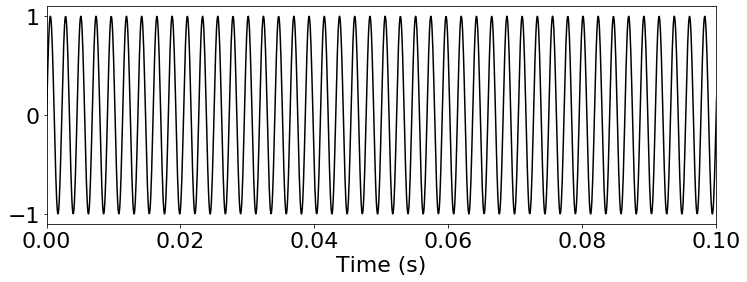

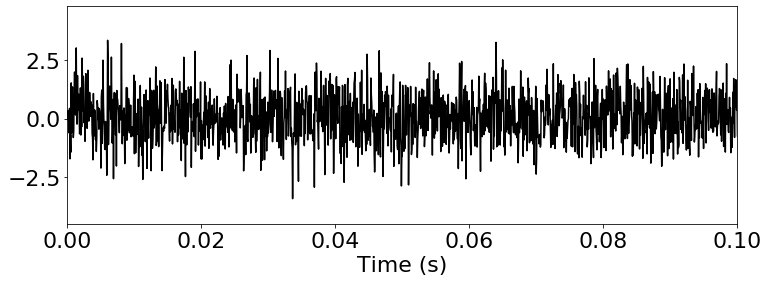

In [4]:
sr = 16000                   # sampling rate in Hz
T = 2                        # duratio in seconds
t = np.arange(sr*T)/sr       # time array
x = np.sin(2*np.pi*440*t)    # sinusoidal waveform

plt.plot(t,x,'k'); plt.xlim(0,0.1); plt.xlabel('Time (s)'); plt.show()
display(Audio(x,rate=sr))    # audio player

x = np.random.randn(sr*T)    # random waveform
plt.figure()
plt.plot(t,x,'k'); plt.xlim(0,0.1); plt.xlabel('Time (s)'); plt.show()
display(Audio(x,rate=sr))

## Live coding waveforms

In [5]:
tilt('0.4*sin(t) + rand(88200)*0.3')           # tilt is a livecoding plataform made by Munshkr https://munshkr.gitlab.io/tilt/

# Numbers

- Rational numbers as harmonics in a string or simple frequency quotients intervals 
- Irrational numbers and noise
- Number theory functions sonification

##  Harmonics in string and rational numbers

We rise the question: How can we compute the note or frequency that will sound if we excite an harmonic in a string by pressing it in a given location?

In [6]:
IFrame(width=560,height=315,src="https://www.youtube.com/embed/awQBh9ADp98?start=25")

The harmonic series generates numbers $n$ that indicate the number of nodes in a normal mode of vibration, then the positions of the nodes in the string are multiples of the ratio $\frac{1}{n}$

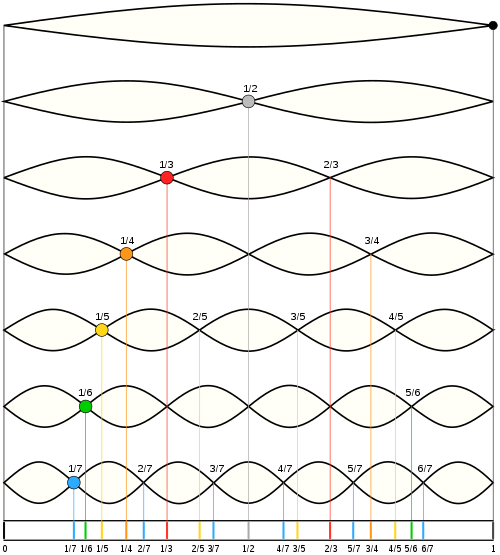

Given a position $x$ in the string, we want to identify the nearest node of an harmonic with lower denominator because higher harmonics are quieter and far in the auditory range. 

In other words, given a real number $x$ and a maximum harmonic $N$, we want a rational number $\frac{k}{n}$ that aproximates $x$ with the lowest $n<N$  

<!--
We can limit the highest harmonic we want $N$, and then compute:  

$$ n = \min \left\{ \operatorname*{arg min}_{n<N, k} |x-\frac{k}{n}| \right\}$$ 

At the end this is a special quantizing of the string that follows a Farey series.

Length wave and frequency formula

$$ \lambda = \frac{2L}{n} $$

$$ f = \frac{n}{2L} $$

Length wave formula
 -->

In [7]:
display(Latex('$N=9$'))
N = 9 # highest harmonic
xs = [0.5,0.1,0.15]
for x in xs:
    fr = str(nearest_reduced_ratio(x, N)[0])
    display(Latex(f'${x} \\approx {fr}$'))

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

Now for a string position $x$ between 0 and 1 and maximum harmonic 9

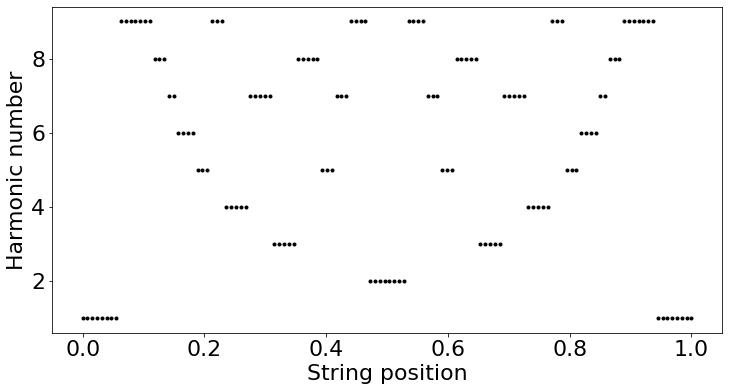

In [8]:
x = np.linspace(0,1,128)
fractions = nearest_reduced_ratio(x,N)
n = [f.denominator for f in fractions]

plt.figure(figsize=(12,6))
plt.plot( x , n ,'.k')

plt.xlabel('String position')
plt.ylabel('Harmonic number');

Now create a sequence of notes simulating we are moving throw the string of a violoncello tuned to A2 (110 Hz)

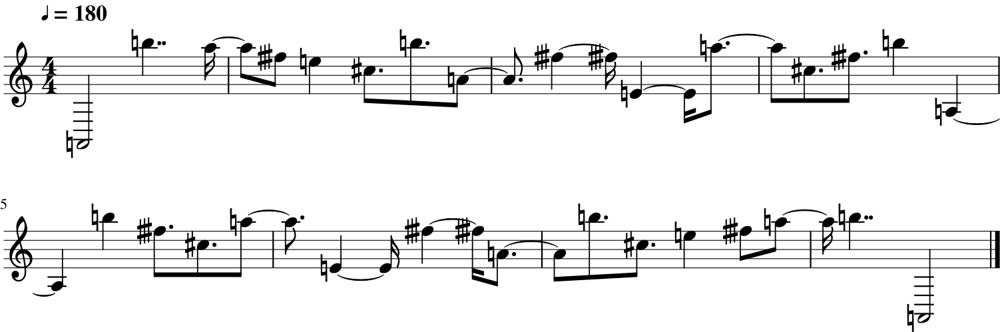

In [9]:
N = 9                                       # maximum harmonic
x = np.linspace(0,1,128)                    # position over the string with 1/128 resolution
fractions = nearest_reduced_ratio(x,N)      # small ratio rational numbers from the positions 
n = [f.denominator for f in fractions]      # harmonics taken from the denominators

durations = [len(list(g))*0.25 for e, g in groupby(n)] # durations of the harmonic while moving
harmonics = [e for e, g in groupby(n)]      # harmonics

freqs = np.array(harmonics)*110             # multiplying by the fundamental frequency
notes = 12*np.log2(freqs/440.0) + 69        # transforming to notes in midi format

# showing and playing
score = secuencia(list(notes),duraciones=durations, scale=None, bpm=180, instrumento=m21.instrument.Violoncello())
score.show()
score.play()

The sequence of harmonics that rise in this problem corresponds to the [Farey sequence](https://en.wikipedia.org/wiki/Farey_sequence). In our example, the Farey sequence F9. 

In [10]:
seq = farey(9)
print('Farey 9 sequence')
print(seq)

Farey 9 sequence
[(0/1), (1/9), (1/8), (1/7), (1/6), (1/5), (2/9), (1/4), (2/7), (1/3), (3/8), (2/5), (3/7), (4/9), (1/2), (5/9), (4/7), (3/5), (5/8), (2/3), (5/7), (3/4), (7/9), (4/5), (5/6), (6/7), (7/8), (8/9), (1/1)]


If we draw the sequence denominators in a grid the same pattern appears. 

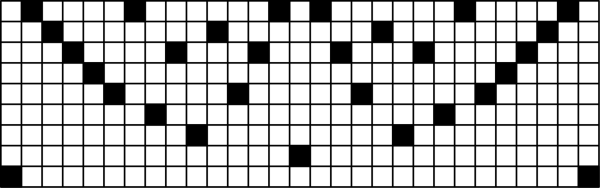

Now lets use this grid as a score and divide it in two instrument of different registers, a trombone for the first 4 harmonics, and a guitar for the rest.


In [11]:
seq = farey(9)

harmonics = [s.denominator for s in seq] # taking the denominator from the farey sequence

freqs = np.array(harmonics)*110          # multiplying by the fundamental frequency
notes = 12*np.log2(freqs/440.0) + 69     # transforming to notes in midi format

limit = 45+28
rep = 2

score1 = secuencia([n-12 if n<limit else "" for n in notes]*rep, duraciones=0.25, scale=None, bpm=120, velocidades=127, instrumento=m21.instrument.Trombone())
score2 = secuencia([n-12 if n>=limit else "" for n in notes]*rep, duraciones=0.25, scale=None, bpm=120, velocidades=84, instrumento=m21.instrument.Guitar())

score = score1 + score2
# score.show()
score.play()

Now, lets try some extreme examples, the Farey 96 sequence, starting from the lowest key in a piano (A0) to near end (E7)

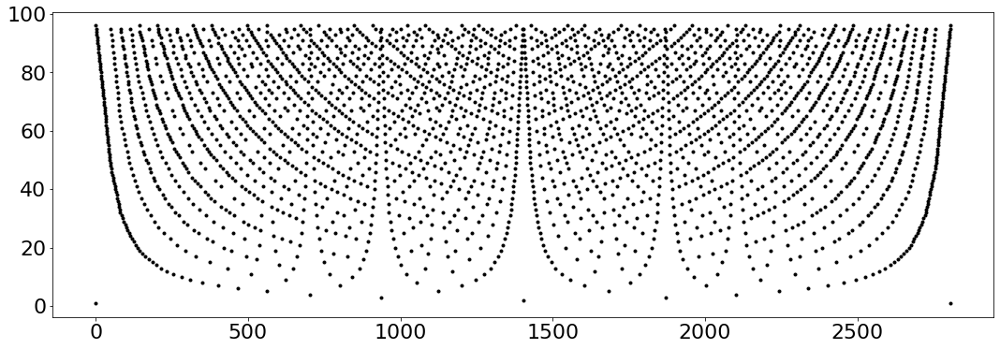

In [12]:
seq = farey(96)

harmonics = [s.denominator for s in seq]         # taking the denominator from the farey sequence

freqs = np.array(harmonics)*110                  # multiplying by the fundamental frequency
notes = 12*np.log2(freqs/440.0) + 69 - 12*3.5    # transforming to notes in midi format

plt.figure(figsize=(18,6))
plt.plot([s.denominator for s in seq],'.k');

score = secuencia(list(notes),duraciones=0.25, scale=None, bpm=180)
# score.show()
filename = score.to_wav(dir=temp_dir)
Audio(url=str(Path(temp_dir,Path(filename).name)),embed=False)

In [13]:
# x = np.linspace(0,1,1000)
# N = 9
# fractions = nearest_reduced_ratio(x,N)
# devil = [float(f) for f in fractions]
# plt.plot(devil,'.')

### Existing connections between music and farey series and music 

- György Ligeti: Étude No. 13: L'escalier du diable / The Devil’s Staircase thttps://www.youtube.com/watch?v=Oj4Ye7h2d88&app=desktop
- Krantz et al (2010). The Farey series devil's staircase: Connection to dynamical-systems, statistical physics, music theory and music perception?. Bulletin of the American Physical Society.
- Cartwright et al (2010). Two musical paths to the Farey series and devil's staircase. Journal of Mathematics and Music.
- Extreme piano scores: Conlon Nancarrow Study #37 for Player Piano https://www.youtube.com/watch?v=g0gNoELvpPo


# Irrational numbers and noise

How are the digits of irrational numbers distributed? Let try to listen to pi

In [14]:
with open('pi1000000.txt') as fp:
    pi = fp.read()
pi[:100]  # first 100 digits of pi

'3.14159265358979323846264338327950288419716939937510582097494459230781640628620899862803482534211706'

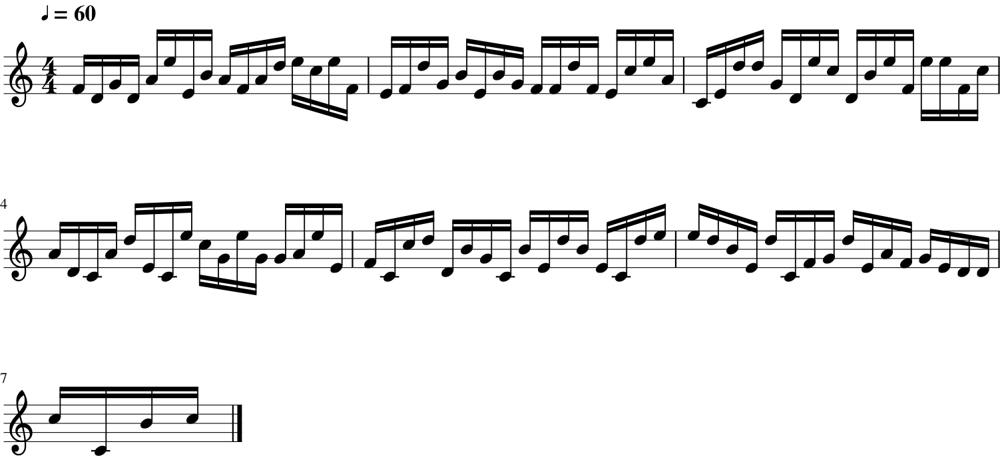

In [15]:
pi = pi.replace('.','') # remove the dot
notes = list(map(int,pi))
score = secuencia(notes[:100], duraciones=0.25, bpm=60)
score.show()
score.play()

In [16]:
# pi = pi.replace('.','') # remove the dot
# notes = list(map(int,pi))
# durs = list(map(lambda x: 2**(2-int(x)%5),pi)) # 
# vels = list(map(lambda x: int(x)//5*47+80,pi))

# score = secuencia(notes[:48:2], duraciones=durs[1:48:2], velocidades=vels[1:48:2], scale=m21.scale.LydianScale('C'), bpm=120)
# score.show()
# score.play()

If we continue listening, every possible combination of notes will appear eventually. Lets try to listen to it in a different way to include more digits. For that is convinient to generate a waveform directly from the digits sequence.

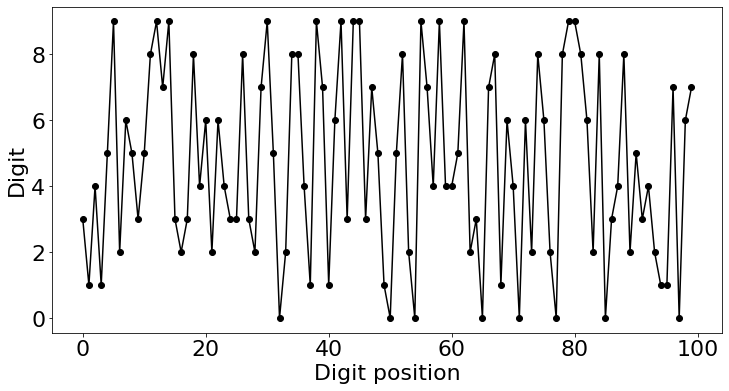

In [17]:
x = np.array(list(map(int,pi))) # convert string of characters to array of numbers
plt.figure(figsize=(12,6))
plt.plot(x[:100], 'o-', color='k')
plt.xlabel('Digit position')
plt.ylabel('Digit')
x = x - 4.5 # center
AudioPlayer(x,rate=44100,name='pi_noise') # watch the volume!

## Number theory functions sonification

Are prime numbers distributed randomly? Let's try to hear some series made from functions related to numbers properties

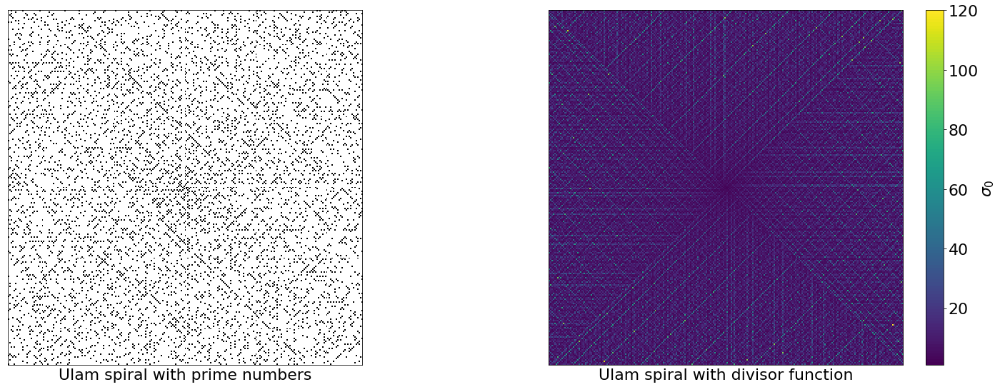

In [18]:
df = pd.read_pickle('primes.pickle')

m = 251
n = 251
c_m = m//2
c_n = n//2
points = spiral(n, m)

ix = []
for p in points:
    ix.append((p[1]+c_m)*n+p[0]+c_n)

M = np.zeros(m*n)
x = (df.ndivisors.values[:m*n]+1)/np.log(np.arange(2,n*m+2))
x = df.ndivisors.values[:m*n]+1
M[ix] = x
M = M.reshape(m,n)

plt.figure(figsize=(22,8))

plt.subplot(1,2,2)
colors = np.array(plt.cm.viridis(np.linspace(0,1,M.max()))).copy()
# colors[1]=[1.0,0,0,0.2]
cmap = mpl.colors.ListedColormap(colors)
plt.imshow(M,aspect='equal',interpolation='none',cmap=cmap)
plt.xticks([]);plt.yticks([])
plt.xlabel('Ulam spiral with divisor function')
plt.colorbar(label='$\sigma_0$',fraction=0.046, pad=0.04);

plt.subplot(1,2,1)

plt.imshow(M==2,aspect='equal',interpolation='none',cmap=plt.cm.gray_r)
plt.xticks([]);plt.yticks([]);
plt.xlabel('Ulam spiral with prime numbers')
plt.tight_layout()

### Functions

* $ \sigma_0(n)$, divisor function, the number of divisors of an integer (including 1 and the number itself). For a prime number the value is 2. Normalized version: $\sigma_0(n)/log(n)$
    
* $\omega(n)$, the number of distinct prime factors of $n$. For a prime number, the value is 1.

* $\phi(n)$, Euler's totient function. For given $n$, this function counts the quantity of coprimes with $n$. A prime number has $n$ - 1 comprimes, every number beneath them minus their self. Normalized version: $\tilde{\phi}(n)=(\phi(n)+1)/n$, prime numbers have a value of one.

* Distance to next prime

* Log normalized prime gap, $g_n = \frac{p_{n+1} - p_n}{log(n)}$

In [19]:
fs = 3000
x = df.normndiv.values;x = x - x.mean()
display(Latex('Log normalized divisors function $\sigma_0$'))
display(AudioPlayer(x,rate=fs,name='sigma'))

x = df.nuniquefactors.values;x = x - x.mean()
display(Latex('Distinct prime factor $\omega$ function'))
display(AudioPlayer(x,rate=fs,name='omega'))

x = df.normtotient.values;x = x - x.mean()
display(Latex('Normalized Euler Totient function $\phi$'))
display(AudioPlayer(x,rate=fs,name='phi'))

x = df.distance2prime.values;x = x - x.mean()
display(Latex('Distance to next prime function'))
display(AudioPlayer(x,rate=fs,name='distance_next_prime'))

primos = np.array(df[df.nfactors==1].index)
x = np.diff(primos)/np.log(primos[:-1]);x = x - x.mean()
display(Latex('Log normalized prime gap'))
display(AudioPlayer(x,rate=fs,name='prime_gap'))

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

### Spectrum analysis 

The spectrum of the divisors function shows a recursive pattern, with some visual resamble to the Farey series pattern. The main spectral peaks are given by the expression:

$$ f_n = \frac{sr}{n} $$

with $sr$ the samping rate in this case 3000 Hz.

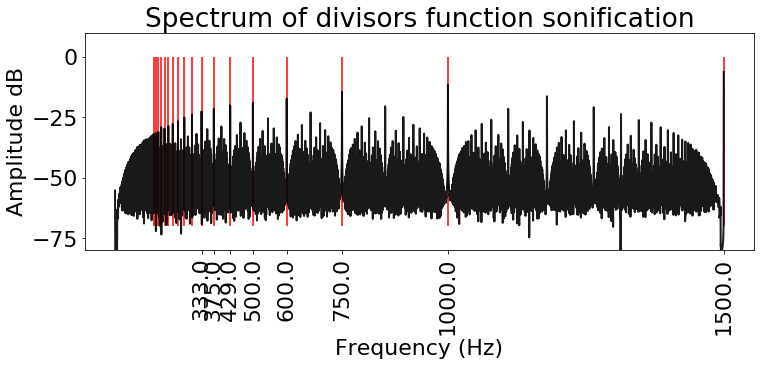

In [20]:
x = df.normndiv.values;x = x - x.mean()

n_fft=2**15
S = abs(librosa.stft(x,n_fft=n_fft)/n_fft*2.0)**2
S = S.mean(1)
P = 10*np.log10(S)
freqs = librosa.fft_frequencies(sr=3000,n_fft=n_fft)

plt.figure(figsize=(12,4))
plt.plot(2**(freqs/1000), P,'k-',lw=2,alpha=0.9)
# base = 28*np.log10(freqs/3500+1e-15)
# base[0]=base[1]
# plt.plot(freqs, base )

freqs_ = 3000/np.arange(2,20) 
plt.vlines(2**(freqs_/1000),-70,0,color='r')

plt.title('Spectrum of divisors function sonification')

plt.ylim(-80,10)
freqs_ = 3000/np.arange(2,10,1)
plt.xticks(2**(freqs_/1000),np.around(freqs_),rotation=90)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude dB');

In [21]:
# # [float(f)*1500 for f in farey(9)]
# plt.figure(figsize=(12,4))

# plt.plot(freqs, P,'k-',lw=2,alpha=0.9)
# plt.xlim(60,1600)
# plt.xscale('log')

# plt.vlines(3000/np.arange(1,30),-70,0,color='r')
# plt.vlines(3000/np.arange(1,30)*2,-70,0,color='b')

### Divisor Function Chord  

Microtonal tunning


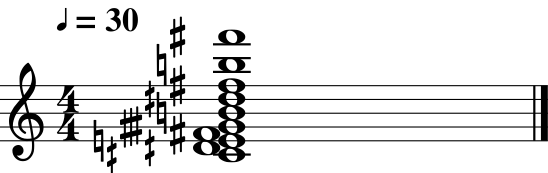

Tempered tunning D 6/9 Chord


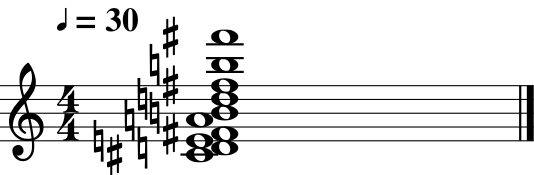

In [22]:
freqs_peaks = 3000/np.arange(2,12)
notes = 12*np.log2(freqs_peaks/440.0) + 69 # transforming to notes in midi format
dbs = 28*np.log10(freqs_peaks/3500+1e-15)
vels = 127*10**((dbs+11)/40)

print('Microtonal tunning')

score = secuencia([tuple(notes)], duraciones=[4], velocidades=vels, scale=None, bpm=30, instrumento= m21.instrument.Viola())
score.show()

display(score.play())

print('Tempered tunning D 6/9 Chord')
score = secuencia([tuple(np.around(notes)[-10:])], duraciones=[4], velocidades=vels,scale=None, bpm=30, instrumento= m21.instrument.Viola())
score.show()
score.play()

# Modular arithmetic and phase

* $\mathbb{Z}_{12}$, scales and pitch circularity
* Phase of periodic functions, sound synthesis, frequency modulation and calculus
* Fourier analysis, magnitude and phase spectrograms 

## $\mathbb{Z}_{12}$, scales and pitch circularity

Western music is made from 12 notes with group properties

<div class="output_html">
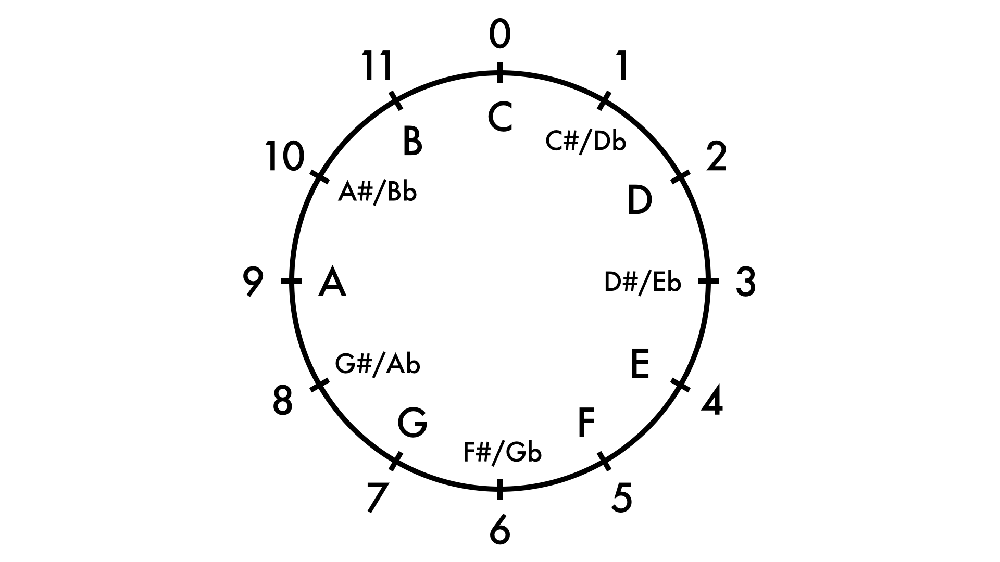
</div>

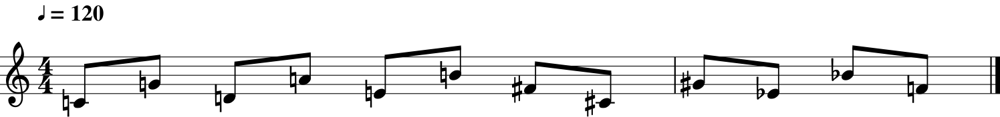

In [23]:
seq = np.arange(0,7*12,7) % 12 + 60
score = secuencia(list(seq), duraciones=0.5, bpm=120, scale=None)
score.show()
score.play()

[[0 2 4 6]
 [3 5 0 2]
 [6 1 3 5]
 [2 4 6 1]
 [5 0 2 4]
 [1 3 5 0]
 [4 6 1 3]
 [0 2 4 6]]


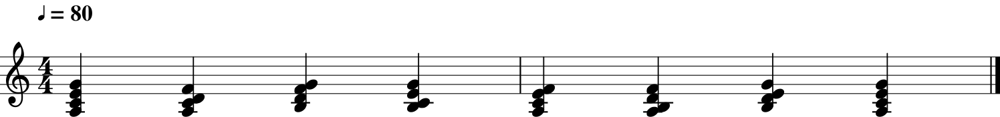

In [24]:
seq = np.array([ (np.array([0,2,4,6]) + n) % 7 for n in [0, 3, 6, 9, 12, 15, 18, 21]])
print(seq)
score = secuencia(seq, duraciones=1, bpm=80, scale=m21.scale.MinorScale('A'), octava=3)
score.show()
score.play()

### References

* Johnson, C. M. (2009). Introducing Group Theory through Music. Mathematics Teacher, 103(2), 116-122.
* Mazzola, G. (2012). The topos of music: geometric logic of concepts, theory, and performance. Birkhäuser.
* Benson, D. (2006). Music: A mathematical offering. Cambridge University Press.

## Phase of periodic functions, sound synthesis, frequency modulation and calculus

Lets generate a sound wave from a periodic function. In this case, a pure tone with 440 Hz in frequency.
$$ f = 440 $$
$$ x(t) = \sin(2\pi f t) $$

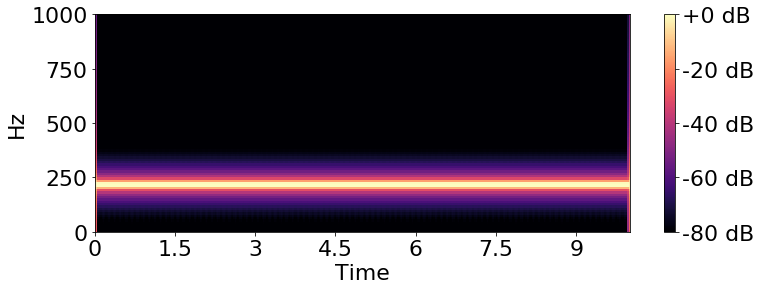

In [25]:
sr = 44100
T = 5
t = np.arange(0,T*sr)/sr
x = np.sin(2*np.pi*440*t)
plt.figure(figsize=(12,4))
spectrogram(x,fmax=1000)
Audio(x, rate = sr)

Now lets ask, how can we create a siren sound or a frequency modulated sound. For example, a pure tone with a frequency that changes from 220 Hz and to 660 Hz sinusoidally at 1 Hz. First idea will be:

$$ f = 440 + 220 \sin(2\pi 1 t ) $$
$$ x(t) = \sin(2\pi f t) $$

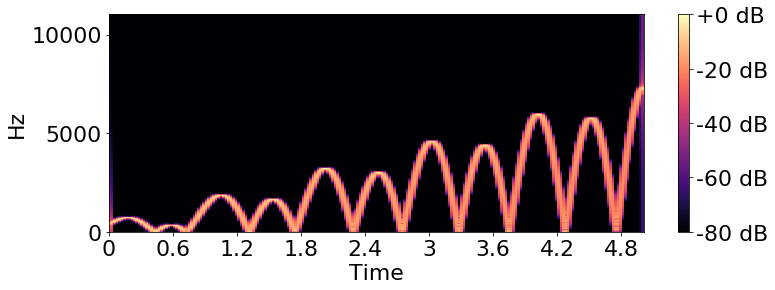

In [26]:
sr = 22050
T = 5
t = np.arange(0,T*sr)/sr
x = np.sin(2*np.pi*(440 + 220*np.sin(2*np.pi*1*t))*t )
plt.figure(figsize=(12,4))
spectrogram(x)
Audio(x, rate = sr)

The result is not the expected one. What happened? We modulated the phase, but not the frequency. We must treat the problem as an oscillatory or circular motion problem where the frequency is the _velocity_ of the phase.

$$ \frac{d\theta(t)}{dt} = 2 \pi f(t) $$

$$ \theta(t) = 2 \pi \int f(t) dt $$

$$ \theta(t) = 2 \pi \int 440 + 220 \sin(2\pi 1 t ) dt $$

$$ \theta(t) = 2 \pi 440 t - 220 \cos(2\pi 1 t ) $$



In [27]:
from sympy import Symbol, integrate, sin, pi

t = Symbol('t')
result = integrate(2*pi*(440 + 220*sin(2*pi*1*t)))
display(Latex(r"$\theta(t)=$"))
display(result)

result = result.replace(t,t/(2*pi*440)).simplify()
display(Latex(r"$\theta(\frac{t}{2\pi440})=$"))
display(result)
result = sin(result)
tilt('0.5*'+str(result))    

<IPython.core.display.Latex object>

2*pi*(440*t - 110*cos(2*pi*t)/pi)

<IPython.core.display.Latex object>

t - 220*cos(t/440)

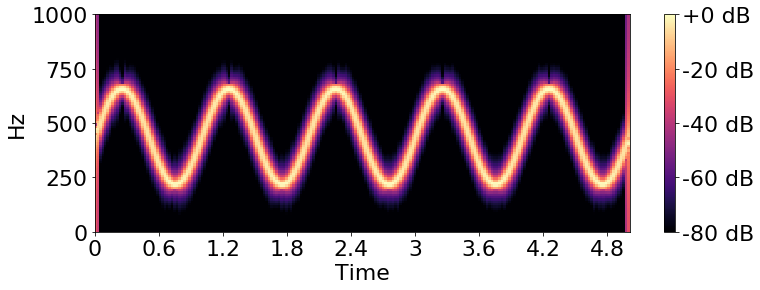

In [28]:
sr = 22050
T = 5
t = np.arange(0,T*sr)/sr

freq = (440 + 220*np.sin(2*np.pi*1*t))
phase = np.cumsum(freq)/sr

x = np.sin(2*np.pi*phase)
plt.figure(figsize=(12,4))
spectrogram(x,fmax=1000)
Audio(x, rate = sr)

If we consider numeric integrals we can design a sound with an arbitrary intantaneous frequency, for example with an stochastic component

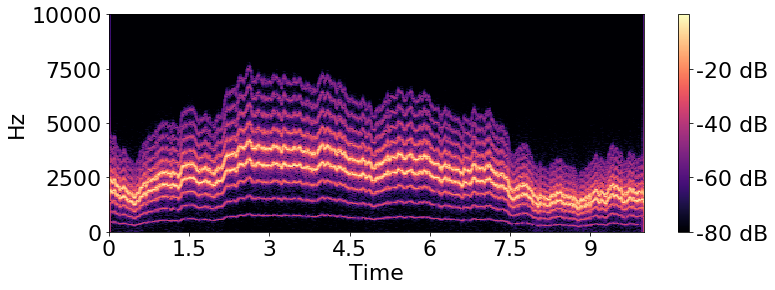

In [29]:
sr = 22050
T = 10
t = np.arange(0,T*sr)/sr

freq0 = 440 + np.cumsum(np.random.randn(t.size)*0.8)
x = np.zeros(t.size)
for i in range(1,10,1):
    freq = freq0*i
    phase = np.cumsum(freq)/sr
    x += np.sin(2*np.pi*phase)/(i-4.5)**2
    
plt.figure(figsize=(12,4))
spectrogram(x,fmax=10000)
Audio(x, rate = sr)

# Fourier analysis and phase manipulations

The fourier transform of a time series results in magnitude $M_k$ and phase $\phi_k$ values. Because it is an invertible process, we can modify the phase values and listen to the changes to understand its properties.


$$ M_k e^{i\phi_k} = 
\sum _{n=0}^{N-1}x_{n}\cdot e^{-{\frac {i2\pi }{N}}kn} $$

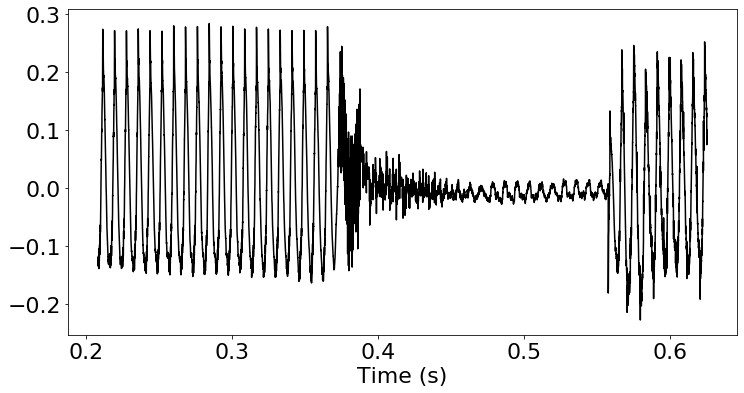

In [71]:
filename = 'wavs/Chico Buarque - Essa Moça Tá Diferente ( 8-bit Sounds )-uZgaJsHBuOw.wav'
x, sr  = librosa.load(filename,sr = None)
x = np.trim_zeros(x)
if x.size%2!=0:
    x = x[:-1]
t = np.arange(x.size)/sr
plt.figure(figsize=(12,6))
plt.plot(t[10000:30000], x[10000:30000],'k')
plt.xlabel('Time (s)')
Audio(url=filename,embed=False)

## Magnitude and phase spectrogram

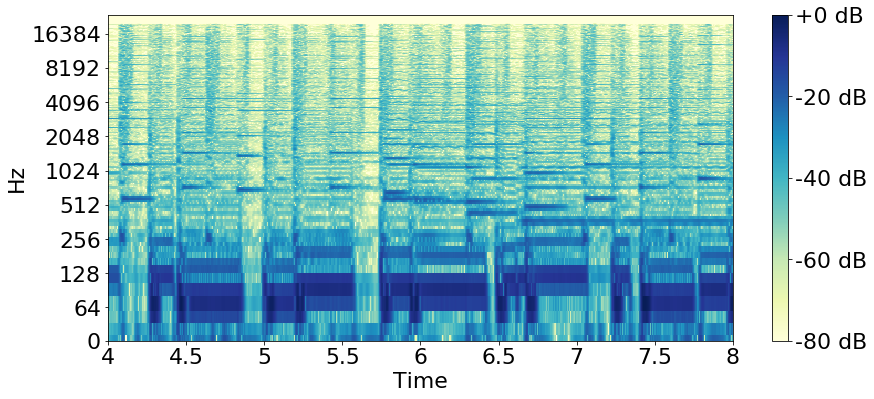

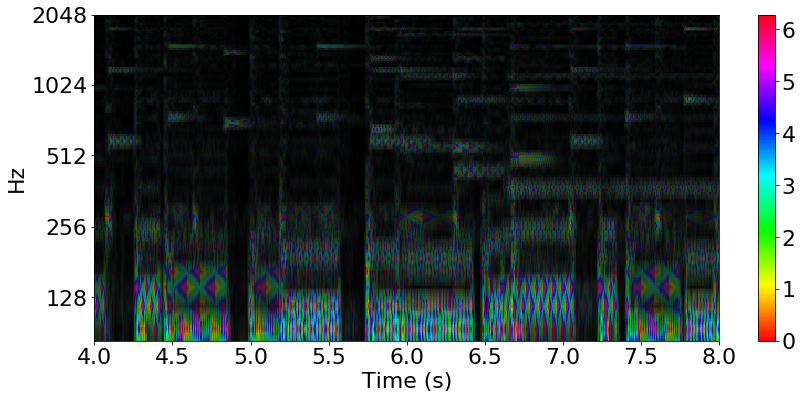

In [72]:
signal = x[sr*20:sr*40]
frame_length = 4096//2
hop_length = 340#frame_length//6
S = librosa.stft(signal, n_fft=frame_length,hop_length=hop_length)
D = librosa.amplitude_to_db(np.abs(S), ref=np.max)
fft_frequencies = librosa.fft_frequencies(sr=sr,n_fft=frame_length)
frames_time = librosa.frames_to_time(np.arange(S.shape[1]),sr=sr,hop_length=hop_length)

plt.figure(figsize=(14,6))
librosa.display.specshow(D, x_axis='time', y_axis='log',cmap=plt.cm.YlGnBu,sr=sr, hop_length=hop_length)
plt.colorbar(format='%+2.0f dB');
plt.xlim(4,8)


plt.figure(figsize=(14,6))
ph = np.angle(S)
M = np.abs(S/S.shape[0])
log_freq_bins = 500
M, log_fft_frequencies = log_freqs_interp(M,log_freq_bins,fft_frequencies, frames_time)
ph, log_fft_frequencies = log_freqs_interp(ph,log_freq_bins,fft_frequencies, frames_time)
X = magphase_hsv(M,ph)
plt.imshow(X,aspect='auto',origin='bottom',extent=[0,signal.size/sr,0,M.shape[0]])
freqs = [2**i for i in range(5,14)]
bins = [np.where(log_fft_frequencies>f)[0][0] for f in freqs]
plt.yticks(ticks=bins,labels=freqs)
plt.ylim(np.where(log_fft_frequencies>84)[0][0],np.where(log_fft_frequencies>2048)[0][0])
plt.xlabel('Time (s)')
plt.ylabel('Hz');
plt.xlim(4,8)
norm = mpl.colors.Normalize(vmin=0, vmax=2*np.pi)
plt.colorbar(plt.cm.ScalarMappable(norm=norm,cmap=plt.cm.hsv));

## Random phase (aka. filtered noise)


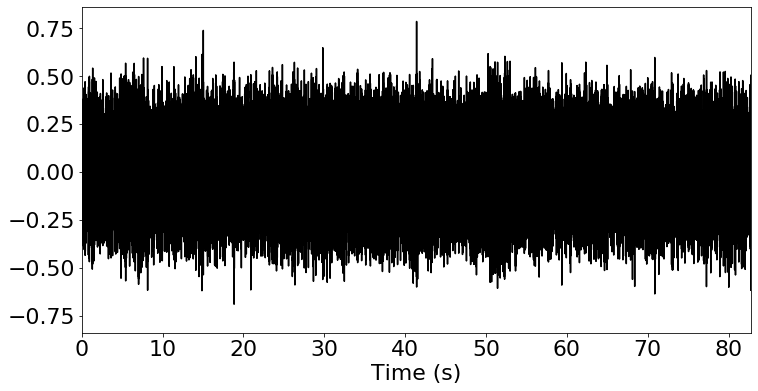

In [73]:
phi = np.random.rand(x.size//2+1)*2*np.pi
y = np.fft.irfft(np.abs(np.fft.rfft(x))*np.exp(1j*phi))
plt.figure(figsize=(12,6))
plt.plot(t, y, color='k')
plt.xlim(0,t[-1]/2)
plt.xlabel('Time (s)')
AudioPlayer(y,rate=sr,name='random_phase')

## Constant phase (aka. autocorrelation function)


$$ \phi_k = 0 $$

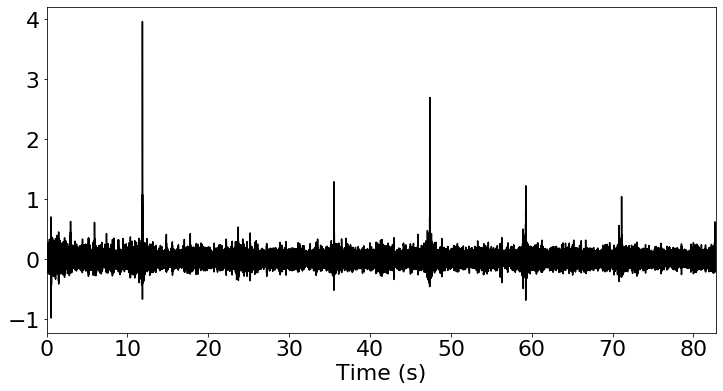

In [76]:
y = np.fft.irfft(np.abs(np.fft.rfft(x)))
y = tukey(y.size,0.01)*y
plt.figure(figsize=(12,6))
plt.plot(t, y, color='k')
plt.xlim(0,t[-1]/2)
plt.xlabel('Time (s)')
AudioPlayer(y,sr,name='ACF')

### References

* Smith, J. O. (2002). Mathematics of the discrete fourier transform (dft). Center for Computer Research in Music and Acoustics (CCRMA), Department of Music, Stanford University, Stanford, California.
* Smith, J. O. (2011). Spectral audio signal processing. W3K publishing.
* Benson, D. (2006). Music: A mathematical offering. Cambridge University Press.